In [4]:
import os
import glob
from dicompylercore import dicomparser as dp
import torch
from torchvision.transforms import ToTensor
from torchvision import transforms
import matplotlib.pyplot as plt
import numpy as np
import cv2
import pydicom
import re

def get_rt_parser(ruta):
    # Crear diccionario para almacenar los rt_parsers
    rt_parsers = {'RTSTRUCT': None, 'RTDOSE': None, 'CT': []}

    # Obtener la lista de archivos dicom dentro de la subcarpeta del paciente
    archivos_dicom = glob.glob(os.path.join(ruta, "*.dcm*"))

    # Procesar cada archivo DICOM
    for archivo_dicom in archivos_dicom:
        # Crear el path completo al archivo DICOM
        ruta_dicom = os.path.join(ruta, archivo_dicom)
        # Crear un objeto DicomParser para el archivo DICOM
        dicom_parser = dp.DicomParser(ruta_dicom)
        series_info = dicom_parser.GetSeriesInfo()

        # Verificar el atributo 'Modality' 
        if series_info['modality'] == 'CT':
            rt_parsers['CT'].append(dicom_parser)
        elif series_info['modality'] == 'RTSTRUCT':
            rt_parsers['RTSTRUCT'] = dicom_parser
        elif series_info['modality'] == 'RTDOSE':
            rt_parsers['RTDOSE'] = dicom_parser

    return rt_parsers

def detectar_etiqueta(texto, etiqueta):
    patrones = [
        r'\b{}\b'.format(etiqueta),
        r'\b[^\s]*{}[^\s]*\b'.format(etiqueta),  
    ]

    for patron in patrones:
        coincidencias = re.findall(patron, texto, flags=re.IGNORECASE)
        if coincidencias:
            return coincidencias[0] 

    return None

def get_dic_posiciones(rt_parsers):  
    dic_posiciones = dict()
    structure_parser = rt_parsers['RTSTRUCT']
    structures = structure_parser.GetStructures()
    
    for referencia in ['PTV', 'vejiga', 'recto', 'cuerpo']:
        for posicion, dic_info in structures.items():
            match = detectar_etiqueta(dic_info['name'], referencia)
            if match is not None: 
                dic_posiciones[referencia] = posicion
                
    return dic_posiciones, structure_parser

def get_coordenadas(dic_posiciones, structure_parser):
    dic_coordenadas = dict()
    dic_coordenadas_ok = dict()

    for etiqueta, posicion in dic_posiciones.items():
        coordenadas = structure_parser.GetStructureCoordinates(posicion) 
        dic_coordenadas[etiqueta] = coordenadas

    for etiqueta, coordenadas_sucias in dic_coordenadas.items():
        dic_aux = dict()  # Inicializar dic_aux en cada iteración del bucle exterior
        for z, lista_diccionarios in coordenadas_sucias.items():
            data = lista_diccionarios[0]['data']
            dic_aux[z] = data
        dic_coordenadas_ok[etiqueta] = dic_aux 

    return dic_coordenadas_ok

def get_tensor_ct(rt_parsers):
    informacion_cortes = dict()
    ct_parsers = rt_parsers['CT']
    
    for ct_parser in ct_parsers:
        coordenada_z = ct_parser.GetImageLocation()
        datos_ct = ct_parser.GetImageData()
        imagen_ct = ct_parser.GetImage()

        # Acceder a las filas y columnas
        filas = datos_ct['rows']
        columnas = datos_ct['columns']

        # Almacenar la información en el diccionario
        informacion_cortes[coordenada_z] = {'coordenada_z': coordenada_z, 'imagen_ct': imagen_ct}
        
    # Obtener las coordenadas Z ordenadas
    coordenadas_z_ordenadas = sorted(informacion_cortes.keys())
    profundidad = len(coordenadas_z_ordenadas)
    
    # Crear un tensor RGB 
    tensor_rgb = torch.zeros((profundidad, filas, columnas, 3), dtype=torch.float32)

    # Crear un objeto ToTensor para convertir la imagen a tensor
    to_tensor = ToTensor()
    
    for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
        # Acceder a la imagen CT del diccionario
        imagen_ct = informacion_cortes[coordenada_z]['imagen_ct']
    
        # Convertir la imagen a tensor
        tensor_imagen_ct = to_tensor(imagen_ct)
    
        # Asignar la imagen CT al canal B del tensor RGB
        tensor_rgb[i, :, :, 2] = tensor_imagen_ct[0]  

    return tensor_rgb, filas, columnas, coordenadas_z_ordenadas, datos_ct, informacion_cortes

def get_tensor_estructuras(dic_coordenadas, tensor_rgb, filas, columnas, coordenadas_z_ordenadas):
    dic_mascaras = dict()
    dic_coordenadas_sinz_estructuras = dict()
    # vamos a preparar las coordenadas para conseguir las mascaras
    for estructura, coordenadas in dic_coordenadas.items():
        coordenadas_sinz = dict()
        
        # Iterar sobre los cortes y coordenadas
        for corte, coordenadas_conz in coordenadas.items():
            # Convertir a numpy array
            coordenadas_conz = np.array(coordenadas_conz, dtype=float)
            coordenadas_sin_z = coordenadas_conz[:, :2]
            # guardar las coordenadas por su z
            coordenadas_sinz[corte] = coordenadas_sin_z
            
        dic_coordenadas_sinz_estructuras[estructura] = coordenadas_sinz
    #print('prueba', dic_coordenadas_sinz_estructuras['cuerpo']) #HASTA ACA ANDA 

    # vamos a formar las mascaras de las estructuras
    for estructura, coordenadas_sinz in dic_coordenadas_sinz_estructuras.items():
        dic_mascaras_aux = dict()
        for corte, coordenadas in coordenadas_sinz.items():
            # Centrar la figura (ajustar al centro de la imagen)
            coordenadas[:, :2] += [columnas // 2, filas // 2]
            coordenadas_ajustadas = (coordenadas).astype(np.int32)
            # Crear una imagen en blanco
            img = np.zeros((filas, columnas), dtype=np.uint8)
            
            # Dibujar el polígono en la imagen
            cv2.fillPoly(img, [coordenadas_ajustadas], 255)

            #guardamos
            dic_mascaras_aux[corte] = img
        dic_mascaras[estructura] = dic_mascaras_aux

    #print("coordenadas z ordenadas", coordenadas_z_ordenadas)
    # Crear un objeto ToTensor para convertir la imagen a tensor
    to_tensor = ToTensor()
    # vamos a cargar las mascaras en el tensor
    
    for estructuras, dic_masc in dic_mascaras.items():
       
        for corte, mascara in dic_masc.items(): 
            corte_2 = round(float(corte), 2)
            for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
                if estructuras == "PTV" and corte_2 == coordenada_z:
                    #Convertir la imagen a tensor
                    tensor_mascara = to_tensor(mascara)
                    # Asignar la mascara al canal G del tensor RGB
                    tensor_rgb[i, :, :, 1] = tensor_mascara
                    
                if estructuras == "recto" and corte_2 == coordenada_z:
                    # Convertir la imagen a tensor
                    tensor_mascara = to_tensor(mascara)
                    # Asignar la imagen CT al canal B del tensor RGB
                    tensor_rgb[i, :, :, 0] = tensor_rgb[i, :, :, 0] + tensor_mascara
                    
                if estructuras == "vejiga" and corte_2 == coordenada_z:
                    # Convertir la imagen a tensor
                    tensor_mascara = to_tensor(mascara)
                    # Asignar la imagen CT al canal B del tensor RGB
                    tensor_rgb[i, :, :, 0] = tensor_rgb[i, :, :, 0] + tensor_mascara*0.75

    # Normalizar entre 0 y 1
    #tensor_rgb_normalized = torch.div(tensor_rgb, tensor_rgb.max()) # ver despues como normaliza el autor 
                         
    return tensor_rgb, dic_coordenadas_sinz_estructuras

def get_tensor_recortado(tensor_rgb_normalized, dic_coordenadas_sinz_estructuras):
    mascaras_rectan = dict()
    lista_x = []
    lista_y = []
    lista_xw = []
    lista_yh = []

    for corte, coordenadas in dic_coordenadas_sinz_estructuras["cuerpo"].items():
        coordenadas1 = [coordenadas.astype(int)]
        x, y, w, h = cv2.boundingRect(coordenadas1[0])
        lista_x.append(x)
        lista_y.append(y)
        lista_xw.append(x + w)
        lista_yh.append(y + h)

    min_x = min(lista_x)
    min_y = min(lista_y)
    max_xw = max(lista_xw)
    max_yh = max(lista_yh)

    tensor_recortado = tensor_rgb_normalized[:, min_y - 4 : max_yh + 4, min_x - 4 : max_xw + 4, :]

    tensor_recortado = tensor_recortado.permute(3,0,1,2)
    return tensor_recortado

def get_tensor_dosis(rt_parsers, coordenadas_z_ordenadas):
    dic_dosis = dict()
    dic_dosis_array = dict()
    profundidad = len(coordenadas_z_ordenadas)

    # Crear un objeto ToTensor para convertir la imagen a tensor
    to_tensor = ToTensor()

    dosis_parser = rt_parsers['RTDOSE']

    data_dosis = dosis_parser.GetDoseData()

    for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
        dosis_array = np.array(dosis_parser.GetDoseGrid(coordenada_z), dtype=float)
        dic_dosis_array[coordenada_z] = dosis_array
        shape = dosis_array.shape
        filas = shape[0]
        columnas = shape[1]
        tensor = to_tensor(dosis_array)
        dic_dosis[i] = tensor

    # Crear un tensor
    tensor_dosis = torch.zeros((profundidad, filas, columnas), dtype=torch.float32)
    for i, tensord in dic_dosis.items():
        tensor_dosis[i, :, :] = tensord

    # Normalizar entre 0 y 1
    #tensor_dosis_normalized = torch.div(tensor_dosis, tensor_dosis.max())  # ver después cómo normaliza el autor

    return tensor_dosis, dic_dosis_array



if __name__ == "__main__":
    
    # Ruta de la carpeta raíz donde se encuentran las subcarpetas de los pacientes
    root_folder = r"C:\Users\ortma\Desktop\FACULTAD\PI\ARCHIVOS_DICOM"
    
    # Ruta de la carpeta donde se crearán las subcarpetas de salida
    output_root_folder = r"C:\Users\ortma\Desktop\FACULTAD\PI\TENSORES PACIENTES"
    
    # Obtener la lista de subcarpetas (pacientes) dentro de la carpeta raíz
    subfolders = sorted(next(os.walk(root_folder))[1])
    
    # Iterar sobre cada subcarpeta (paciente)
    for subfolder in subfolders:
        patient_folder = os.path.join(root_folder, subfolder)
        output_folder = output_root_folder
    
        # Crear la subcarpeta de salida si no existe
        #os.makedirs(output_folder, exist_ok=True)
    
        # llamamos a la funcion que devuelve un diccionario con los rt parsers
        rt_parsers = get_rt_parser (patient_folder)
        
        # llamamos a la funcion que nos devuelve un diccionario de posiciones y el structure_parser, la misma tiene como argumento los rt_parsers
        dic_posiciones, structure_parser = get_dic_posiciones(rt_parsers)
        
        # llamamos a la funcion que nos devuelve el diccionario de coordenadas de cada estructura, tiene como argumento el diccionario de posiciones y structure_parser
        dic_coordenadas = get_coordenadas(dic_posiciones, structure_parser)
        
        # llamamos a la funcion que nos devuelve el tensor rgb (con la CT cargada en el canal B) y otras variables de utilidad, tiene como argumento los rt_parsers
        tensor_rgb, filas, columnas, coordenadas_z_ordenadas, datos_ct, informacion_cortes = get_tensor_ct(rt_parsers)
        
        # llamamos a la funcion que nos devuelve el tensor rgb normalizado, con las estructuras y CT cargados en los canales correspondientes. 
        tensor_rgb_2, dic_coordenadas_sinz_estructuras = get_tensor_estructuras(dic_coordenadas, tensor_rgb, filas, columnas, coordenadas_z_ordenadas)
        
        # llamamos a la funcion que nos devuelve el tensor recortado con dimensiones de [x,128,128,3]
        tensor_recortado_rgb = get_tensor_recortado(tensor_rgb_2, dic_coordenadas_sinz_estructuras)

        print('primera prueba ct', tensor_recortado_rgb.size())
        # llamamos a la funcion que nos devuelve el tensor de dosis normalizado 
        tensor_dosis, dic_dosis_array = get_tensor_dosis(rt_parsers, coordenadas_z_ordenadas)
    
        # Obtener el nombre del archivo sin la ruta y la extensión
        filename = os.path.splitext(os.path.basename(subfolder))[0]
        
        # Construir la ruta de salida para el tensor rgb
        output_file = os.path.join(output_folder, filename + ".pt")
    
        # Asignar el contenido de las variables a un diccionario
        variable = {"imagen": tensor_recortado_rgb, "dosis": tensor_dosis}
        
        # Guardar el diccionario utilizando el nombre de la variable como nombre de archivo

        torch.save(variable, output_file )

        print(datos_ct )
        print('--------------------------------------------------------------------------------------------')
        


        



primera prueba ct torch.Size([3, 123, 287, 375])
{'position': [-250, -250, 139.75], 'orientation': [1, 0, 0, 0, 1, 0], 'pixelspacing': [0.976562, 0.976562], 'rows': 512, 'columns': 512, 'samplesperpixel': 1, 'photometricinterpretation': 'MONOCHROME2', 'littlendian': True, 'patientposition': 'HFS', 'frames': 1}
--------------------------------------------------------------------------------------------
primera prueba ct torch.Size([3, 143, 298, 385])
{'position': [-250, -250, 225.139999], 'orientation': [1, 0, 0, 0, 1, 0], 'pixelspacing': [0.976562, 0.976562], 'rows': 512, 'columns': 512, 'samplesperpixel': 1, 'photometricinterpretation': 'MONOCHROME2', 'littlendian': True, 'patientposition': 'HFS', 'frames': 1}
--------------------------------------------------------------------------------------------
primera prueba ct torch.Size([3, 107, 241, 373])
{'position': [-250, -250, 117.5], 'orientation': [1, 0, 0, 0, 1, 0], 'pixelspacing': [0.976562, 0.976562], 'rows': 512, 'columns': 512, '

AttributeError: 'NoneType' object has no attribute 'GetStructures'

-----------------------------------------------------------------------------------------------------------
Mostramos el tensor rgb recortado


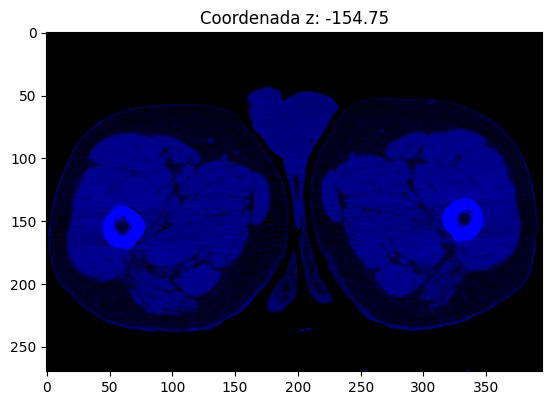

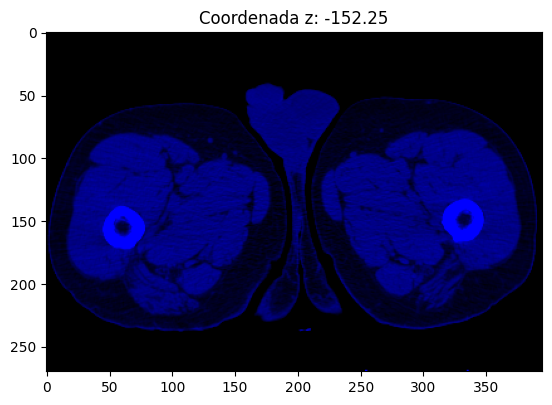

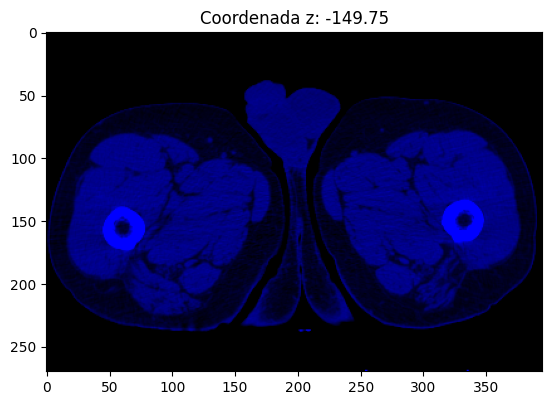

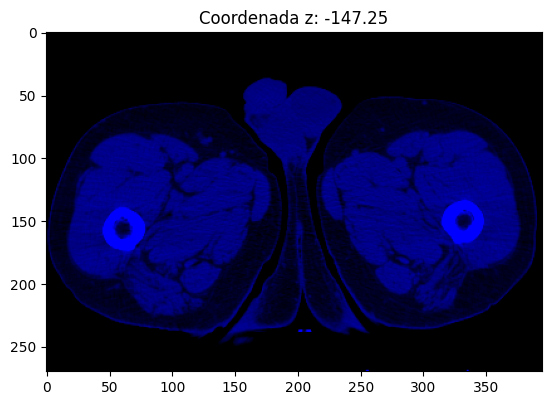

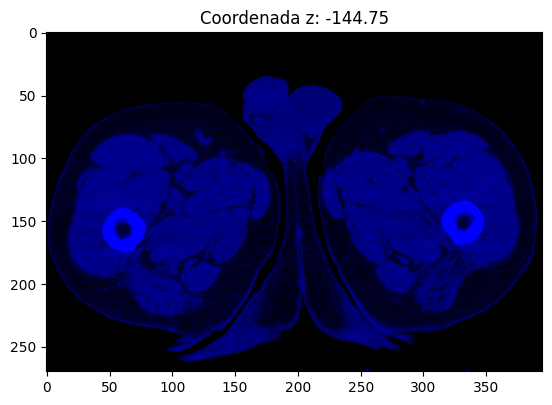

...

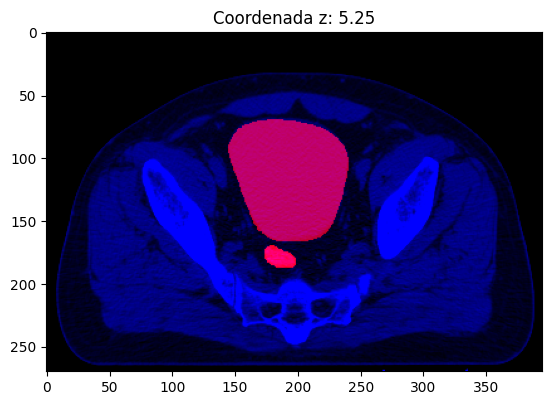

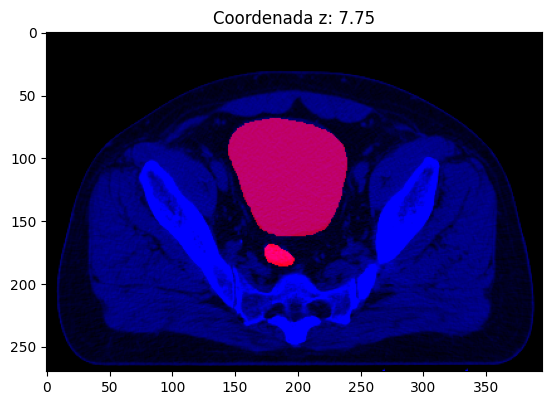

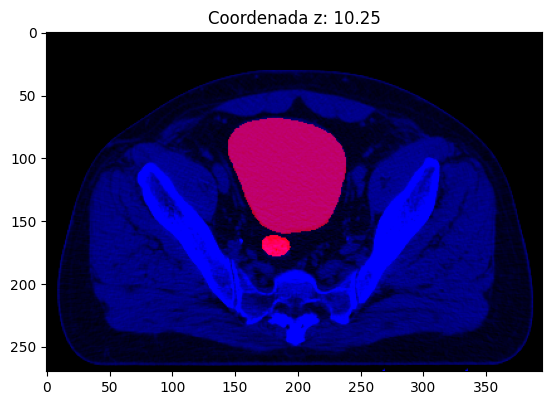

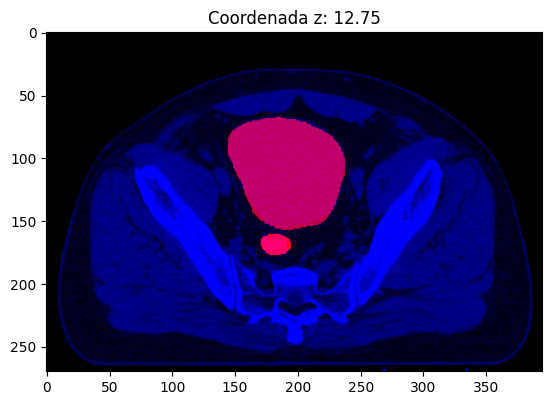

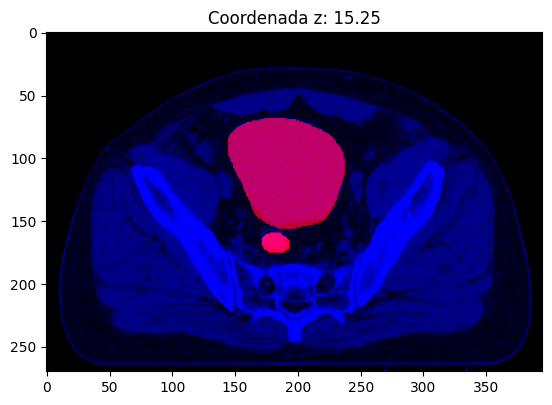

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


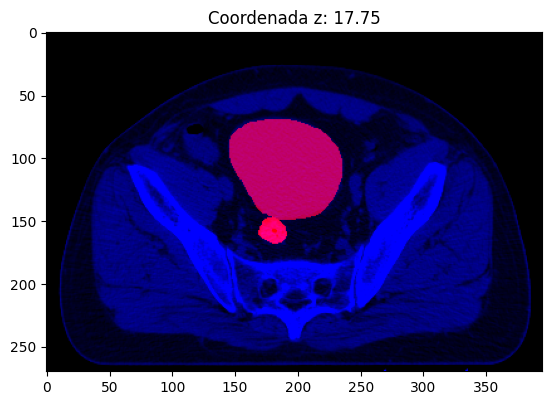

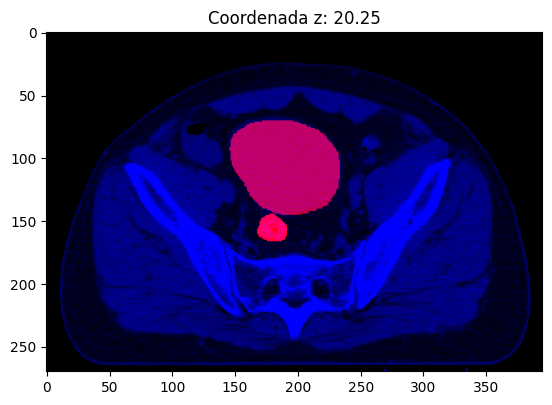

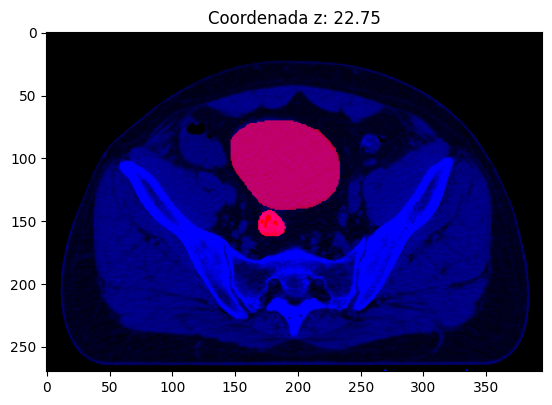

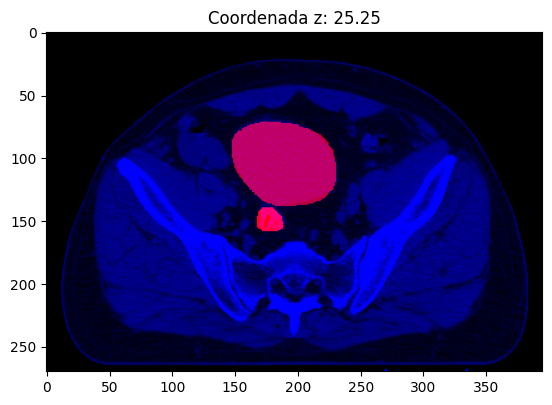

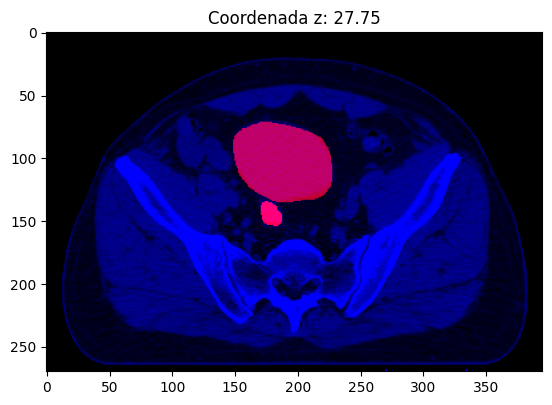

...

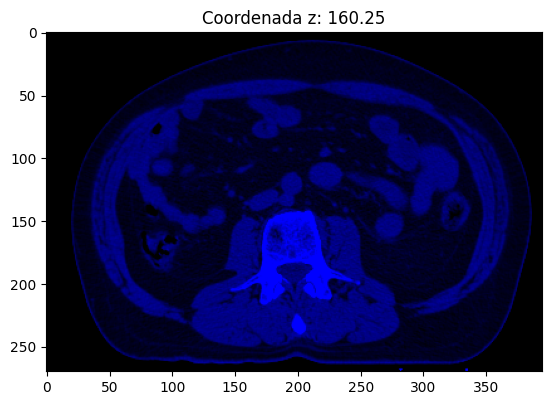

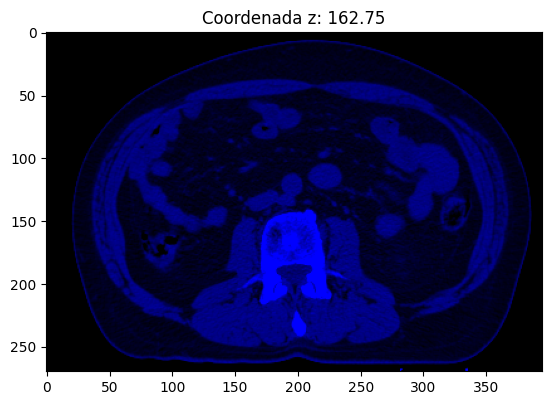

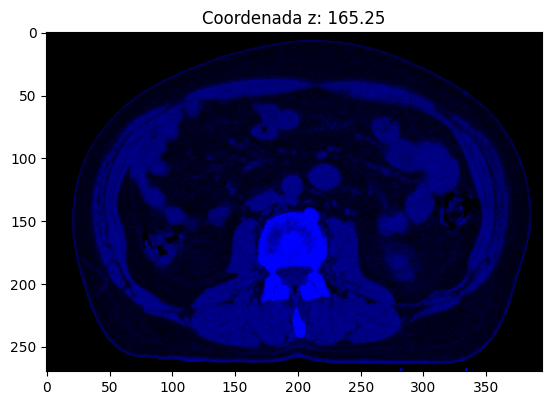

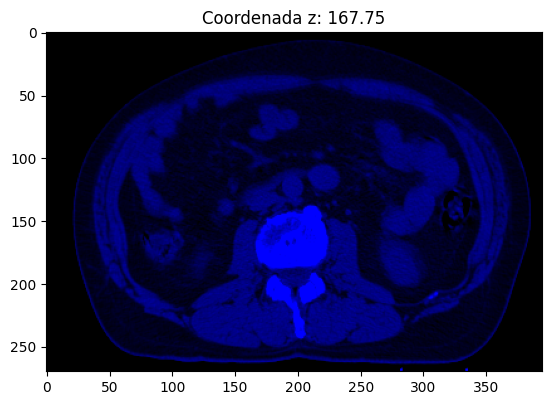

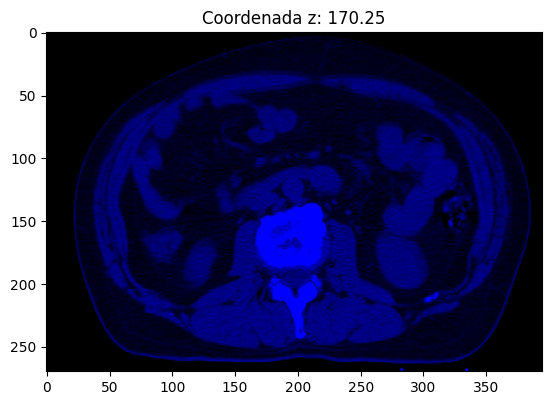

-----------------------------------------------------------------------------------------------------------


In [9]:
# graficamos los resultados obtenidos 

print("-----------------------------------------------------------------------------------------------------------")
print("Mostramos el tensor rgb recortado")
    
for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
    corte_normalizado = tensor_recortado_rgb[i].numpy()
    plt.imshow(corte_normalizado)
    plt.title(f'Coordenada z: {coordenada_z}')
    plt.show()
                    
print("-----------------------------------------------------------------------------------------------------------")


In [6]:
print('tensor rgb', tensor_recortado.shape)

print('tensor dosis', tensor_dosis_normalized.shape)

tensor rgb torch.Size([123, 287, 375, 3])
tensor dosis torch.Size([123, 113, 148])


-----------------------------------------------------------------------------------------------------------
Mostramos el tensor dosis


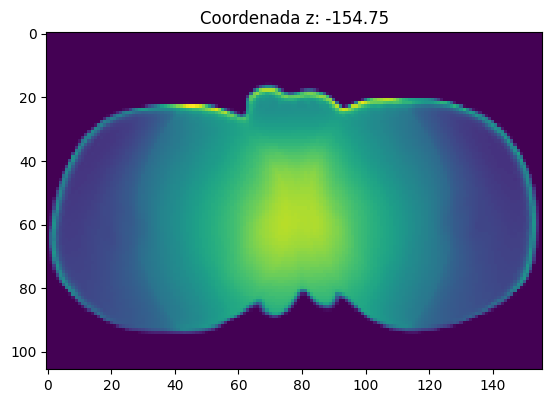

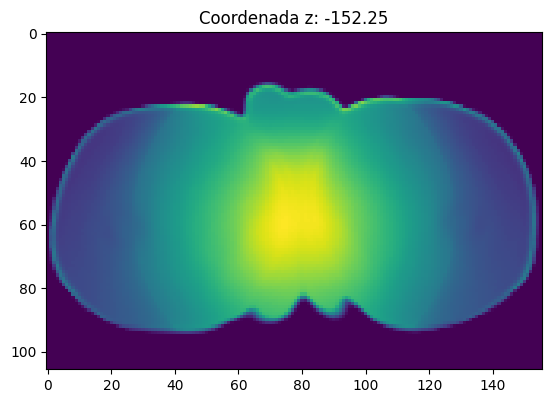

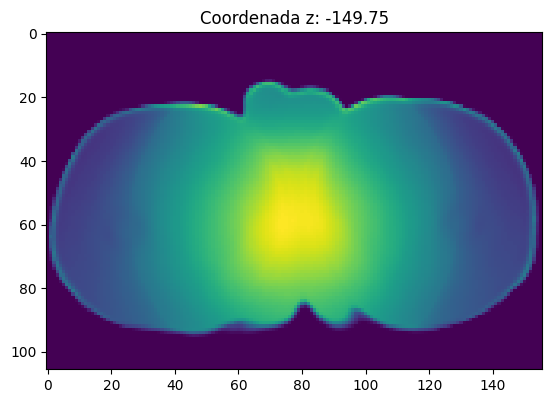

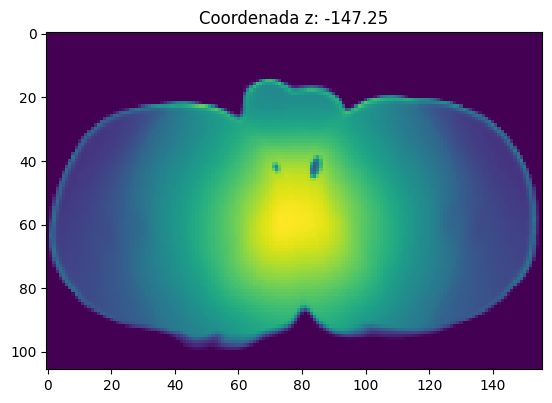

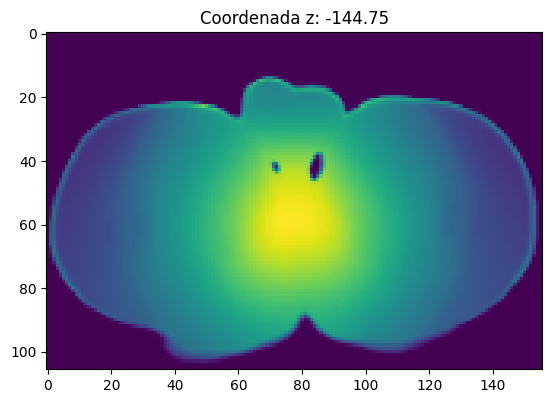

...

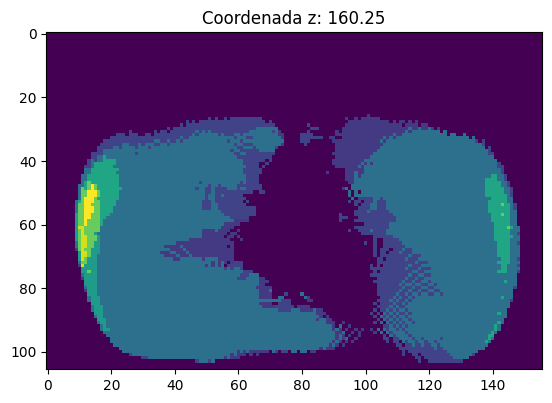

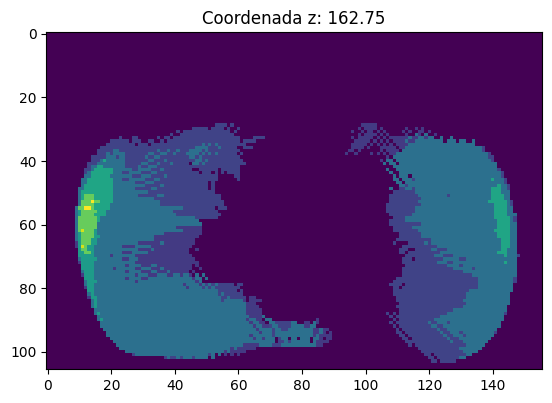

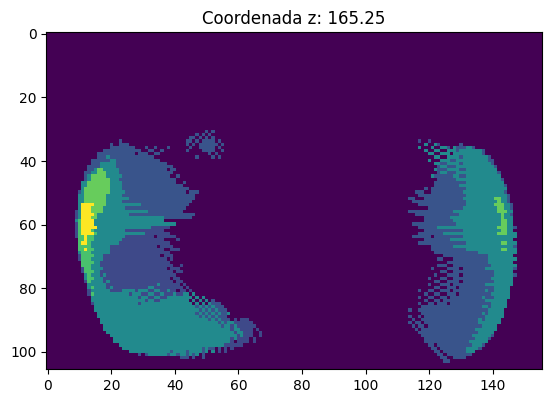

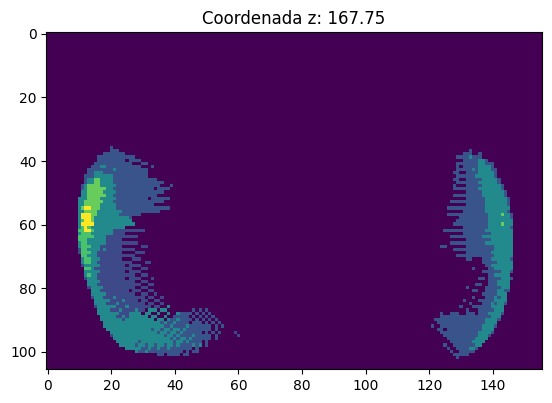

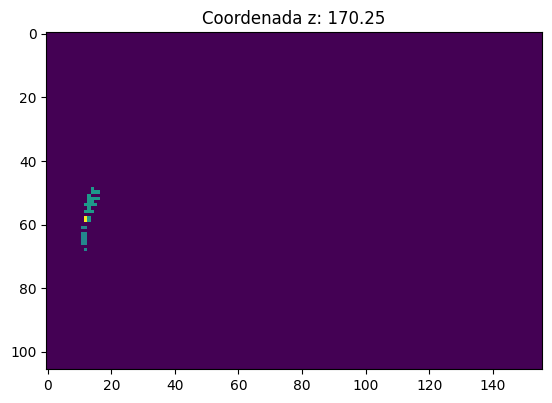

-----------------------------------------------------------------------------------------------------------


In [10]:
print("-----------------------------------------------------------------------------------------------------------")
print("Mostramos el tensor dosis")
    
for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
    corte_normalizado = tensor_dosis[i].numpy()
    plt.imshow(corte_normalizado)
    plt.title(f'Coordenada z: {coordenada_z}')
    plt.show()
                    
print("-----------------------------------------------------------------------------------------------------------")

In [ ]:
# cosas q faltan hacer: 
# redimencionar los tensores y normalizarlos de acuerdo al paper 
# crear el codigo que recorre todas las carpetas de pacientes y aplica las funciones (listo!)
# guardar los tensores rgb y dosis juntos por paciente (no se tienen que mezclar) (maso)

# ver como hacemos data augmentation (ver paper)

# ver teorico de deep learning 
# las bases del deep learning, conceptos
# Estructura de la GAN 
# chequear el dcm (:()


# preguntas a nehuen
# mail de conrrado
# ct y dosis , necesario?
# utilidad de correr los archivos directamente desde drive 

In [92]:
img_prueba = informacion_cortes[-52.25]['imagen_ct']
dosis_prueba = dic_dosis_array[-52.25]

dosis_prueba_resized = np.resize(dosis_prueba, (512,512))
dosis_prueba_resized = itk.image_view_from_array(dosis_prueba_resized)
dosis_prueba_resized_spacing = itk.spacing(dosis_prueba_resized)
print('dosis_prueba_resized_spacing ', dosis_prueba_resized_spacing )

dosis_prueba_resized_spacing  itkVectorD2 ([1, 1])


In [93]:
#!/usr/bin/env python

import sys
import itk

#input_file_name = sys.argv[1]
output_file_name = 'output_dosis.nii'
#scale = float(sys.argv[3])
scale= 1
input_image = itk.image_view_from_array(dosis_prueba)
input_size = itk.size(input_image)
input_spacing = itk.spacing(input_image)
input_origin = itk.origin(input_image)
Dimension = input_image.GetImageDimension()


print('input_size', input_size)
print('input_spacing', input_spacing)



output_image = itk.image_view_from_array(img_prueba)
output_size = itk.size(output_image)
output_spacing = itk.spacing(output_image)
output_origin = itk.origin(input_image)
Dimension = output_image.GetImageDimension()

print('output_origin', output_origin)
print('output_size', output_size)
print('output_spacing', output_spacing)
print('Dimension ', Dimension )

# We will scale the objects in the image by the factor `scale`; that is they
# will be shrunk (scale < 1.0) or enlarged (scale > 1.0).  However, the number
# of pixels for each dimension of the output image will equal the corresponding
# number of pixels in the input image, with cropping or padding as necessary.
# Furthermore, the physical distance between adjacent pixels will be the same
# in the input and the output images.  In contrast, if you want to change the
# resolution of the image without changing the represented physical size of the
# objects in the image, omit the transform and instead supply:
#
# output_size = [int(input_size[d] * scale) for d in range(Dimension)]
# output_spacing = [input_spacing[d] / scale for d in range(Dimension)]
# output_origin = [input_origin[d] + 0.5 * (output_spacing[d] - input_spacing[d])
#                  for d in range(Dimension)]

#output_size = input_size
#output_spacing = input_spacing
#output_origin = input_origin
scale_transform = itk.ScaleTransform[itk.D, Dimension].New()
scale_transform_parameters = scale_transform.GetParameters()
for i in range(len(scale_transform_parameters)):
    scale_transform_parameters[i] = scale
scale_transform_center = [float(int(s / 2)) for s in input_size]
scale_transform.SetParameters(scale_transform_parameters)
scale_transform.SetCenter(scale_transform_center)

interpolator = itk.LinearInterpolateImageFunction.New(input_image)

resampled = itk.resample_image_filter(
    input_image,
    transform=scale_transform,
    interpolator=interpolator,
    size=output_size,
    output_spacing=output_spacing,
    output_origin=output_origin,
)
numpy_array_dosis = itk.array_from_image(resampled)
#itk.imwrite(resampled, output_file_name)

input_size itkSize2 ([156, 106])
input_spacing itkVectorD2 ([1, 1])
output_origin itkPointD2 ([0, 0])
output_size itkSize2 ([512, 512])
output_spacing itkVectorD2 ([1, 1])
Dimension  2


In [87]:
image = itk.image_view_from_array(numpy_array_dosis)
size = itk.size(image)
spacing = itk.spacing(image)
origin = itk.origin(image)
Dimension = image.GetImageDimension()

print('size', size)
print('spacing', spacing)
print('origin', origin)
print('dimension', Dimension)

size itkSize2 ([512, 512])
spacing itkVectorD2 ([1, 1])
origin itkPointD2 ([0, 0])
dimension 2


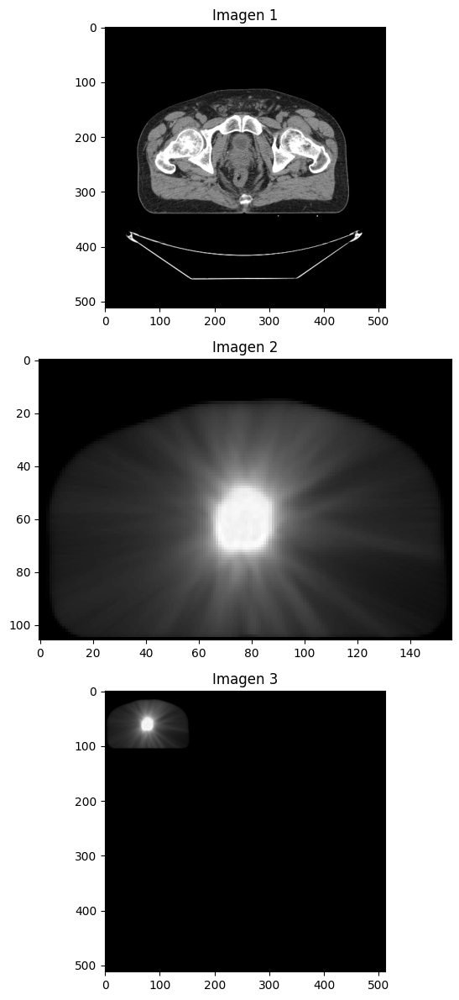

In [88]:
dosis_prueba_normalizado = (dosis_prueba - dosis_prueba.min()) / (dosis_prueba.max() - dosis_prueba.min())
#numpy_array_dosis_normalizado = (numpy_array_dosis - numpy_array_dosis.min()) / (numpy_array_dosis.max() - numpy_array_dosis.min())
# Crear subgráficos
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(6, 12))

# Mostrar la primera imagen
axes[0].imshow(img_prueba, cmap='gray')
axes[0].set_title('Imagen 1')

# Mostrar la segunda imagen
axes[1].imshow(dosis_prueba_normalizado , cmap='gray')
axes[1].set_title('Imagen 2')

# Mostrar la tercera imagen
axes[2].imshow(numpy_array_dosis , cmap='gray')
axes[2].set_title('Imagen 3')

# Ajustar el espacio entre subgráficos
plt.tight_layout()

# Mostrar la figura
plt.show()

-----------------------------------------------------------------------------------------------------------
Mostramos el tensor dosis


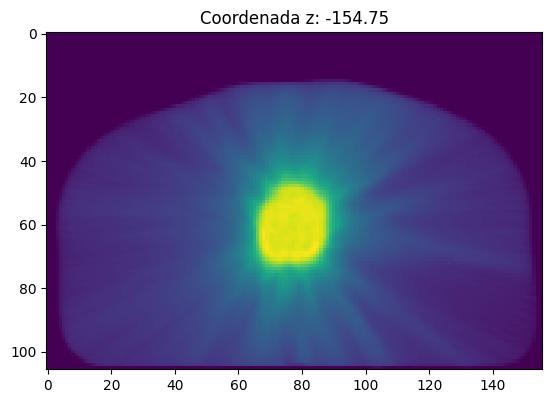

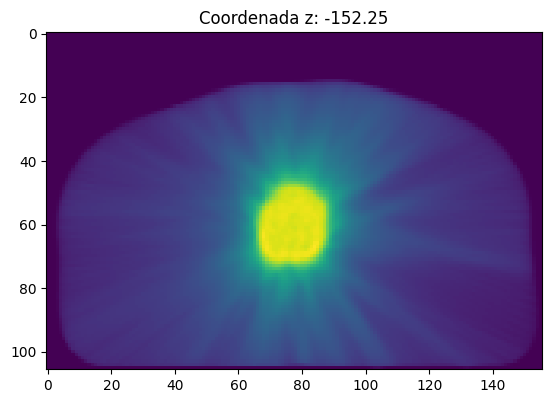

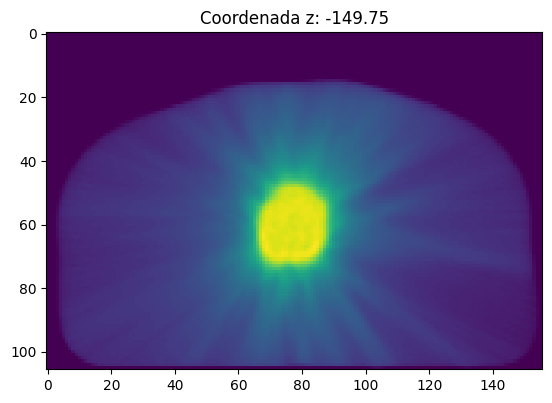

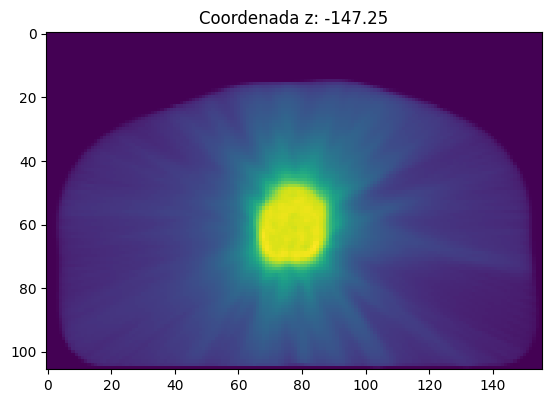

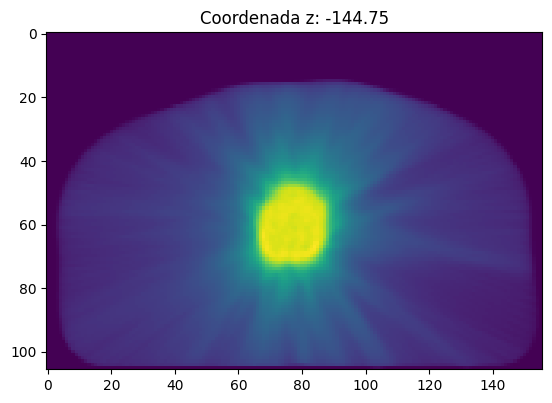

...

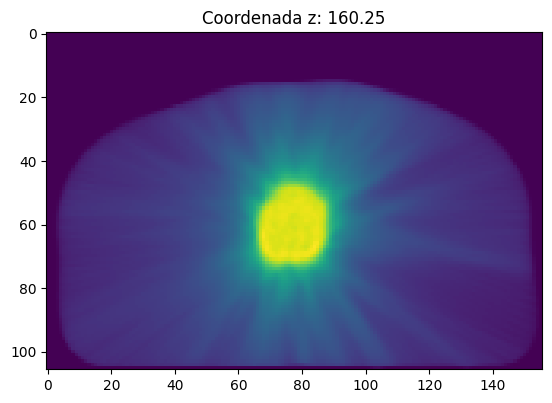

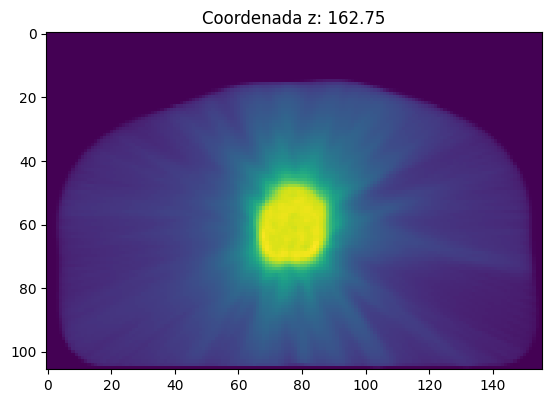

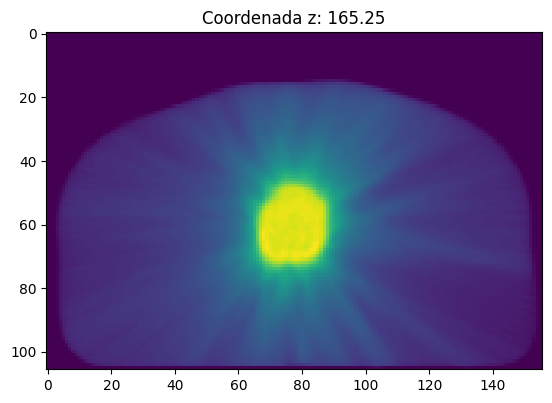

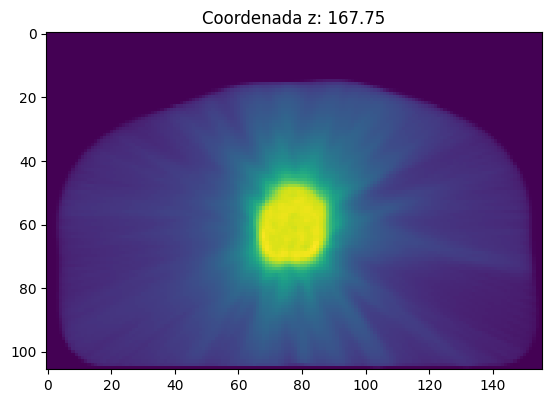

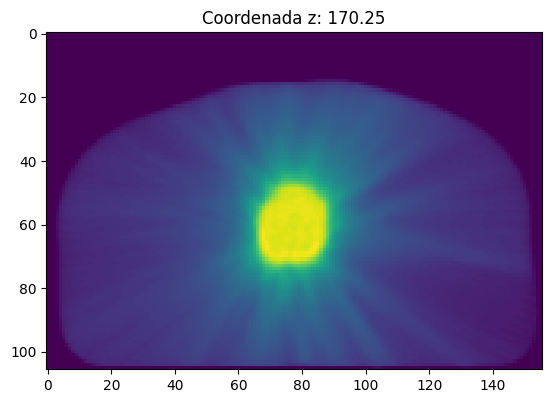

-----------------------------------------------------------------------------------------------------------


In [74]:
print("-----------------------------------------------------------------------------------------------------------")
print("Mostramos el tensor dosis")
    
for i, coordenada_z in enumerate(coordenadas_z_ordenadas):
    corte_normalizado = dic_dosis_array[-52.25]
    plt.imshow(corte_normalizado)
    plt.title(f'Coordenada z: {coordenada_z}')
    plt.show()
                    
print("-----------------------------------------------------------------------------------------------------------")

In [ ]:
def get_resampled_lut(index_extents,
                      extents,
                      new_pixel_spacing,
                      min_pixel_spacing):
    """Determine the patient to pixel LUT based on new pixel spacing.

    Parameters
    ----------
    index_extents : list
        Dose grid extents as array indices.
    extents : list
        Dose grid extents in patient coordinates:
        [col_pos_min, row_pos_min, col_pos_max, row_pos_max].
    new_pixel_spacing : tuple or float
        New pixel spacing in mm (row, column).
        If float is provided, original dose grid pixel spacing must be square.
    min_pixel_spacing : tuple
        Min pixel spacing used to determine new pixel spacing (row, column).

    Returns
    -------
    tuple
        A tuple of lut lists (col lut, row lut) with the coordinates of the
        dose grid in patient coordinates

    Raises
    ------
    AttributeError
        Raised if the new pixel_spacing is not a factor of the minimum pixel
        spacing.

    Notes
    -----
    The new pixel spacing must be a factor of the original (minimum) pixel
    spacing. For example if the original pixel spacing was ``3`` mm, the new
    pixel spacing should be: ``3 / (2^n)`` mm, where ``n`` is an integer.
    This applies independently to both the row and column pixel spacing.

    If a single float value is provided it will be applied to both row and
    column. Additionally, the original dose grid pixel spacing must be square.

    Examples
    --------
    Original pixel spacing: ``3`` mm, new pixel spacing: ``0.375`` mm
    Derived via: ``(3 / 2^16) == 0.375``

    """
    if not isinstance(new_pixel_spacing, Sequence):
        if not (min_pixel_spacing[0] == min_pixel_spacing[1]):
            raise AttributeError(
                "New pixel spacing must be provided as a (row, column) tuple.")
        else:
            new_pixel_spacing = (new_pixel_spacing, new_pixel_spacing)
    if (min_pixel_spacing[0] % new_pixel_spacing[0] != 0.0):
        raise AttributeError(
            "New row pixel spacing must be a factor of %s/(2^n),"
            % min_pixel_spacing[0] +
            " where n is an integer. Value provided was %s."
            % new_pixel_spacing[0])
    if (min_pixel_spacing[1] % new_pixel_spacing[1] != 0.0):
        raise AttributeError(
            "New column pixel spacing must be a factor of %s/(2^n),"
            % min_pixel_spacing[1] +
            " where n is an integer. Value provided was %s."
            % new_pixel_spacing[1])

    # Existing number of cols, rows
    num_cols = abs(index_extents[0] - index_extents[2])
    num_rows = abs(index_extents[1] - index_extents[3])

    col_samples = round(num_cols * min_pixel_spacing[1] / new_pixel_spacing[1])
    row_samples = round(num_rows * min_pixel_spacing[0] / new_pixel_spacing[0])

    col_lut = np.linspace(
        extents[0], extents[2], int(col_samples), dtype=np.float64
    )
    row_lut = np.linspace(
        extents[1], extents[3], int(row_samples), dtype=np.float64
    )
    return col_lut, row_lut